### Bitte lade dir die Daten aus GDrive runter und platziere sie im entsprechenden Verzeichnis
https://drive.google.com/drive/folders/1lWrhk-i7g3Hbl5DWO7DFm6LtL7U_eJBH?usp=sharing

# Absatzprognose für einen Supermarkt
Stell dir vor, du bist ein Data Scientist, der für Favorita, eine Supermarktkette in Ecuador, arbeitet. Du hast Zugang zu einem umfangreichen Datensatz, der Verkaufsinformationen, Angaben zu Geschäften und Produkten sowie zusätzliche wirtschaftliche Indikatoren aus den letzten Jahren enthält. Das Management möchte diese Daten nutzen, um fundierte Entscheidungen treffen zu können. Sie sind besonders daran interessiert, herauszufinden, welche Produktfamilien den höchsten Umsatz erzielen, ob in den Daten Anomalien vorhanden sind und insbesondere, ob die Verkäufe für die nächsten 15 Tage präzise vorhergesagt werden können.

Deine Aufgabe ist es, eine tiefgehende Analyse der bereitgestellten Datensätze durchzuführen. Du hast Zugang zu verschiedenen Dateien: 'train.csv' enthält Zeitreihendaten für verschiedene Merkmale wie Geschäftsnummer (store_nbr), Produktfamilie (family) und Informationen über Promotionen (onpromotion). 'test.csv' gibt dir die Möglichkeit, deine Vorhersagemodelle auf Aktualität zu prüfen. Ergänzende Dateien wie 'stores.csv', 'oil.csv' und 'holidays_events.csv' bieten zusätzliche Kontextinformationen, die bei deiner Analyse hilfreich sein könnten.

### Aufgaben

#### Aufgabe 1. Allgemeine Analyse
1. **Daten laden und inspizieren**: Lade den Datensatz und schau dir die ersten Zeilen an. Überprüfe auch, welche Datentypen die einzelnen Spalten haben.
2. **Zusammenfassende Statistik**: Erstelle eine Übersicht der wichtigsten statistischen Kennzahlen, um ein besseres Gefühl für die Daten zu bekommen. Beispiele könnten sein: 
    - Wie viele Produkte werden verkauft
    - Wie viel Umsatz wurde erwirtschaftet
    - Auswertung hinsichtlich verschiedener Dimensionen ( z. B. : Zeit, Store, Produkt)
    - usw. - Überlege dir weitere Kennzahlen die einen guten Einblick geben könnten
3. **Verkaufsanomalien**: Finde ungewöhnliche Spitzen oder Einbrüche im Verkauf und versuche, die Gründe dafür zu ermitteln.


**INFO: Das Datenset findest du im Ilias Ordner. Speichere es unter tsa02 ab. Beginne mit der Analyse von `train.csv` und ziehe bei Bedarf weitere Daten hinzu.**

In [1]:
import pandas as pd
import numpy as np

df = pd.read_csv("../data/tsa02/train.csv")
df.set_index('id', inplace=True)

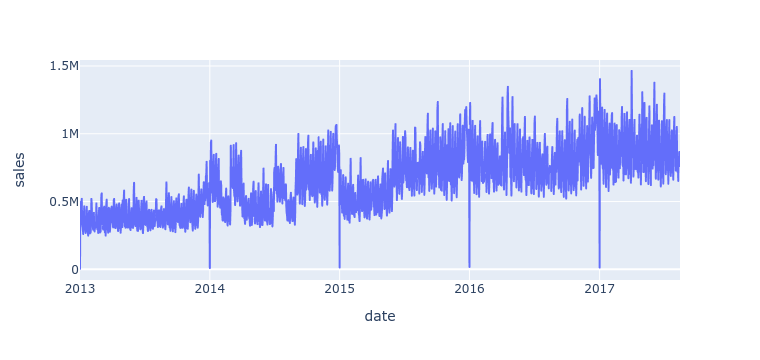

In [2]:
import plotly.express as px

df_sales = df.groupby(['date']).sum()
fig_sales = px.line(df_sales, x=df_sales.index, y="sales")
fig_sales.show()
#df_store = df.groupby(['store_nbr']).sum()
#fig_store = px.line(df_store, x=df_store.index, y="sales")
#fig_store.show()

import plotly.graph_objects as go

df_grouped = df.groupby(['date', 'store_nbr']).sum()
fig = go.Figure(data=[go.Mesh3d(x=df_grouped.index.get_level_values('date'),
                                y=df_grouped.index.get_level_values('store_nbr'),
                                z=df_grouped['sales'])
                     ])
#fig.show()

#### Aufgabe 2. Datenbereinigung und -vorverarbeitung
1. **Probleme und Ausreißer erkennen**: Finde Duplikate und Ausreißer im Datensatz und entscheide, wie diese behandelt werden sollen.
2. **Fehlende Daten finden**: Schau nach, ob im Datensatz Werte fehlen, und überlege dir, wie du damit umgehen willst.

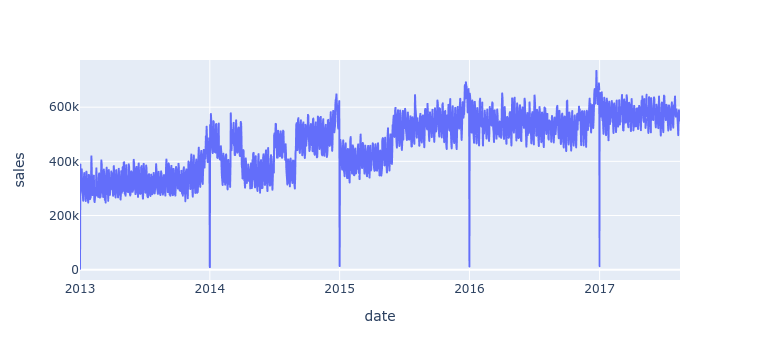

In [3]:
def detect_outliers_zscore(time_series, threshold=2):
    z_scores = (time_series - np.mean(time_series)) / np.std(time_series)
    return np.where(np.abs(z_scores) > threshold)[0]

df = pd.read_csv("../data/tsa02/train.csv")
df.set_index('id', inplace=True)
outliers = detect_outliers_zscore(df['sales'], 4)
df.loc[outliers, 'sales'] = np.nan
df['sales'] = df['sales'].interpolate(method='quadratic')
df_sales = df.groupby(['date']).sum()
fig_sales = px.line(df_sales, x=df_sales.index, y="sales")
fig_sales.show()

#### Aufgabe 3. Umsatzanalyse
1. **Top 5 Umsatzprodukte**: Finde heraus, welche 5 Kategorien (family) am meisten verkauft werden. Führe ein Detailanalyse für 3 dieser Kategorien durch. D.h. Schau dir ihren zeitlichen verlauf an, untersuche mögliche Korrelationen zu anderen Kategorien.
Verwende diese 3 Produkte auch bei den folgenden Aufgaben.

In [4]:
df_family = df.groupby(['family']).sum()
df_family.sort_values('sales', ascending=False).head(3)
# GROCERY I
# BEVERAGES
# CLEANING

,date,store_nbr,sales,onpromotion
family,,,,
GROCERY I,2013-01-012013-01-012013-01-012013-01-012013-0...,2500740,1.794684e+08,1914801
BEVERAGES,2013-01-012013-01-012013-01-012013-01-012013-0...,2500740,1.387906e+08,906958
CLEANING,2013-01-012013-01-012013-01-012013-01-012013-0...,2500740,9.700014e+07,661157


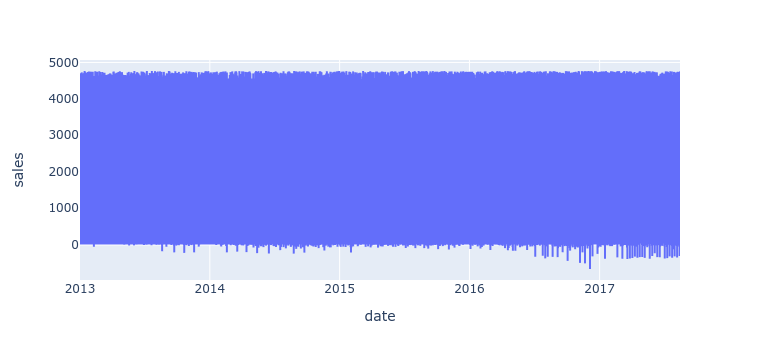

In [5]:
df_grocery = df.loc[df['family'] == 'GROCERY I']
fig_grocery = px.line(df_grocery, x='date', y="sales")
fig_grocery.show()

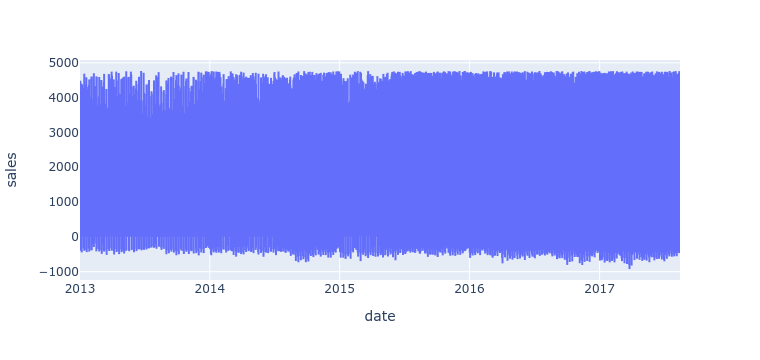

In [6]:
df_beverages = df.loc[df['family'] == 'BEVERAGES']
fig_beverages = px.line(df_beverages, x='date', y="sales")
fig_beverages.show()

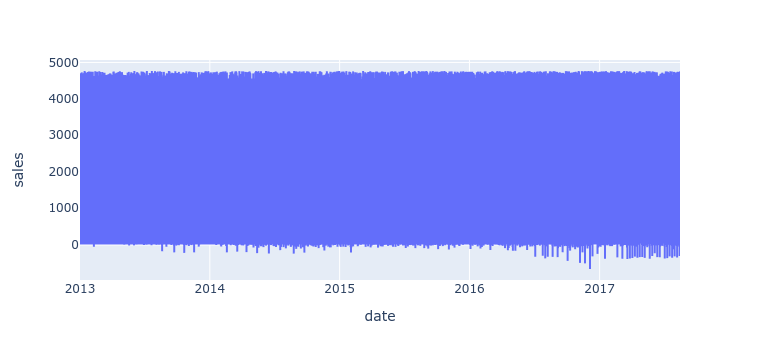

In [7]:
df_cleaning = df.loc[df['family'] == 'CLEANING']
fig_cleaning = px.line(df_grocery, x='date', y="sales")
fig_cleaning.show()

In [14]:
df_stores = df.groupby(['store_nbr']).sum()
df_stores.sort_values('sales', ascending=False).head(3)

,date,family,sales,onpromotion
store_nbr,,,,
44,2013-01-012013-01-012013-01-012013-01-012013-0...,AUTOMOTIVEBABY CAREBEAUTYBEVERAGESBOOKSBREAD/B...,2.318958e+07,192449
46,2013-01-012013-01-012013-01-012013-01-012013-0...,AUTOMOTIVEBABY CAREBEAUTYBEVERAGESBOOKSBREAD/B...,2.291790e+07,190697
45,2013-01-012013-01-012013-01-012013-01-012013-0...,AUTOMOTIVEBABY CAREBEAUTYBEVERAGESBOOKSBREAD/B...,2.217055e+07,191503


#### Aufgabe 4. Zeitreihenanalyse
1. **Zeitreihen zerlegen**: Unterteile die Zeitreihendaten in ihre Bestandteile: Trend, Saisonalität und Rauschen. 
2. **Stationarität überprüfen**: Checke, ob die Zeitreihendaten stationär sind oder nicht.
3. **Auto-Korrelation und partielle Auto-Korrelation**: Erstelle diese Plots, um eventuelle Autokorrelationen in den Zeitreihendaten zu identifizieren.

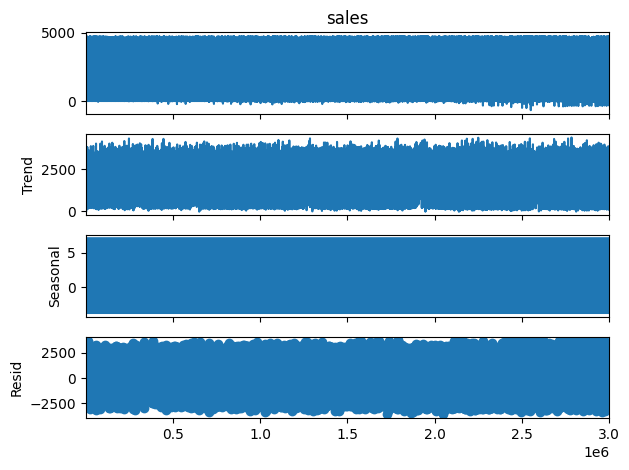

In [8]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot as plt
result = seasonal_decompose(df_grocery['sales'], model='additive', period=5)
result.plot()
plt.show()

In [9]:
from statsmodels.tsa.stattools import adfuller

def adf_test(timeseries):
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
        dftest[0:4],
        index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
        dfoutput["Critical Value (%s)" % key] = value
    print(dfoutput)

adf_test(df_grocery['sales'])

Results of Dickey-Fuller Test:
Test Statistic                   -27.018071
p-value                            0.000000
#Lags Used                        66.000000
Number of Observations Used    90869.000000
Critical Value (1%)               -3.430422
Critical Value (5%)               -2.861572
Critical Value (10%)              -2.566787
dtype: float64


#### Aufgabe 5++ Offene Fragen:
Die folgenden Fragen könnten bei Steakholdern aufkommen. Findest du auf diese Fragen Antworten in den Daten? Stütze deine Erkenntnisse mit Visualisierungen

**Umsatztrends und Saisonalität:**

1. Wie entwickeln sich die Gesamtumsätze von Jahr zu Jahr?
2. Wie variieren die Umsätze nach Monat oder Saison? Gibt es spezifische Monate, in denen die Umsätze deutlich ansteigen oder abnehmen?
3. An welchem Wochentag sind die Umsätze am höchsten?

**Leistung von Produkten und Geschäften:**

4. Welche Produkte sind die Spitzenreiter in Bezug auf Verkaufsvolumen und Umsatz?
5. Gibt es Geschäfte, die konstant besser abschneiden als andere? Was könnte zu ihrem Erfolg beitragen?
6. Wie vergleichen sich die Umsatzleistungen zwischen verschiedenen Geschäftsstandorten oder Regionen?

**Auswirkungen von Promotionen:**

7. Wie beeinflussen Promotionen die Umsätze? Steigern sie die Verkaufsvolumen signifikant?
8. Welche Arten von Promotionen (z.B. Rabatte, Kaufe eins, bekomme eins gratis) haben den größten Einfluss auf die Umsätze?
9. Profitieren alle Geschäfte gleichermaßen von Promotionen, oder gibt es einige, die mehr profitieren als andere?

**Einfluss externer Faktoren:**

10. Wie beeinflussen externe Faktoren wie Feiertage oder lokale Ereignisse die Umsätze?
11. Gibt es bemerkenswerte Veränderungen in den Umsatzmustern während großer Sportereignisse oder bei schlechtem Wetter?

**Kundenverhalten:**

12. Was lässt sich aus den Verkaufsdaten über das Kaufverhalten der Kunden ableiten?
13. Gibt es bestimmte Zeiten im Jahr, in denen die Käufe der Kunden signifikant zu- oder abnehmen?
14. Wie könnten wirtschaftliche Indikatoren die Kaufmuster beeinflussen?

**Lagerverwaltung:**

15.  Wie können wir die Lagerbestände basierend auf historischen Verkaufsdaten optimieren, um Kosten zu senken und den Umschlag zu erhöhen?
16.  Gibt es Muster von Produktretouren, die im Supply-Chain-Management adressiert werden müssen?

**Markterweiterung und strategische Planung:**

17. Angesichts der Verkaufsdaten, welche neuen Standorte sollten für Geschäftserweiterungen in Betracht gezogen werden?
18. Gibt es aufkommende Trends, die neue Produktlinien oder Änderungen in den Geschäftsmodellen vorschlagen?

**Technologische Verbesserungen:**

19. Welche Rolle kann Technologie spielen, um das Kundenverhalten und die Umsatztrends besser zu verstehen und vorherzusagen?
20. Wie können Datenanalysewerkzeuge verbessert werden, um tiefere Einblicke in die Verkaufsdaten zu bieten?

**Risikomanagement:**

21. Was sind die potenziellen Risiken in zukünftigen Umsatztrends und wie können diese gemildert werden?
22. Wie widerstandsfähig sind die Umsätze gegenüber wirtschaftlichen Abschwüngen oder Veränderungen in den Verbraucherpräferenzen?


In [10]:
# Your Code here